In [1]:
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go

pd.options.mode.chained_assignment = None

In [2]:
data_athletes = pd.read_csv("data/athlete_events.csv")
regions = pd.read_csv("data/noc_regions.csv")

# 120 YEARS OF OLYMPIC HISTORY
### Dataset:

Dataset contains 120 years of olympic history, with each row reppresenting a medal that has been won. 

In [3]:
data_athletes.head(3)
#data_athletes.describe()
#regions.head(5)

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal
0,1,A Dijiang,M,24.0,180.0,80.0,China,CHN,1992 Summer,1992,Summer,Barcelona,Basketball,Basketball Men's Basketball,NaN
1,2,A Lamusi,M,23.0,170.0,60.0,China,CHN,2012 Summer,2012,Summer,London,Judo,Judo Men's Extra-Lightweight,NaN
2,3,Gunnar Nielsen Aaby,M,24.0,NaN,NaN,Denmark,DEN,1920 Summer,1920,Summer,Antwerpen,Football,Football Men's Football,NaN


### Rows:

- ID: int 
- Name: String 
- Sex: Char (M or F)
- Age: int
- Height: int 
- Weight: int
- Team: String 
- NOC: String
- Games: String
- Year: int 
- Session: String 
- City: String 
- Sport: String 
- Event: String 
- Medal: String

In [4]:
data = pd.merge(data_athletes, regions, on='NOC', how='left')

goldMedals = data[(data.Medal == 'Gold')]
goldMedals = goldMedals[np.isfinite(goldMedals['Age'])]

goldMedals.head()

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal,region,notes
3,4,Edgar Lindenau Aabye,M,34.0,NaN,NaN,Denmark/Sweden,DEN,1900 Summer,1900,Summer,Paris,Tug-Of-War,Tug-Of-War Men's Tug-Of-War,Gold,Denmark,NaN
42,17,Paavo Johannes Aaltonen,M,28.0,175.0,64.0,Finland,FIN,1948 Summer,1948,Summer,London,Gymnastics,Gymnastics Men's Team All-Around,Gold,Finland,NaN
44,17,Paavo Johannes Aaltonen,M,28.0,175.0,64.0,Finland,FIN,1948 Summer,1948,Summer,London,Gymnastics,Gymnastics Men's Horse Vault,Gold,Finland,NaN
48,17,Paavo Johannes Aaltonen,M,28.0,175.0,64.0,Finland,FIN,1948 Summer,1948,Summer,London,Gymnastics,Gymnastics Men's Pommelled Horse,Gold,Finland,NaN
60,20,Kjetil Andr Aamodt,M,20.0,176.0,85.0,Norway,NOR,1992 Winter,1992,Winter,Albertville,Alpine Skiing,Alpine Skiing Men's Super G,Gold,Norway,NaN


# 1. Age analisis for gold medals


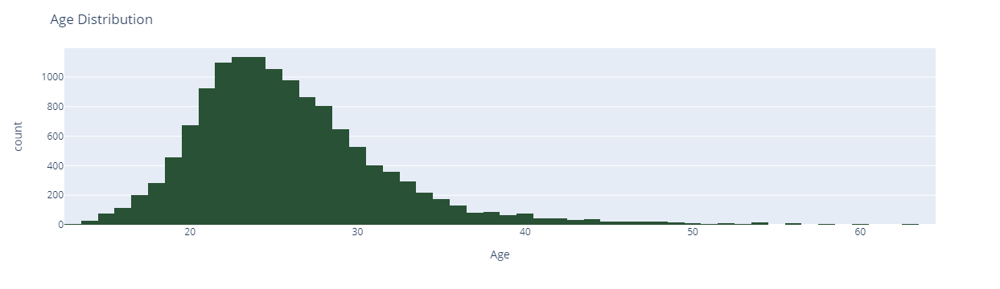

In [5]:
fig  = px.histogram(data_frame = goldMedals, x = "Age", color_discrete_sequence=['#295135'])
fig.update_layout({
    'title': "Age Distribution"
})


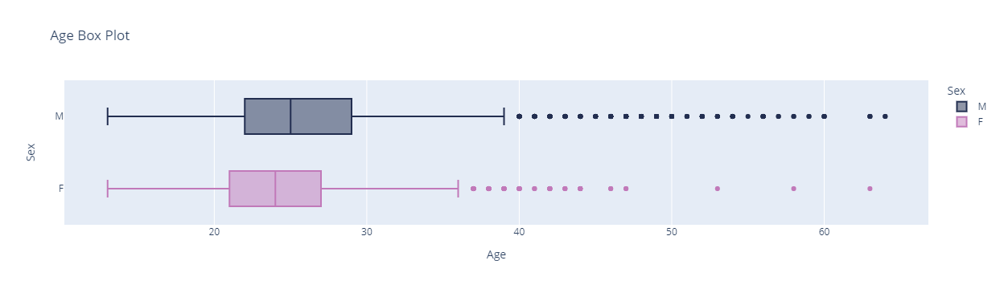

In [6]:
fig = px.box(data_frame = goldMedals, x="Age", y="Sex",color="Sex", title="Age Box Plot",color_discrete_map={
                                                        "M":"#222E50", 
                                                        "F":"#C179B9"})


fig.show()

### Sports that gold medalists over 50 years old play:

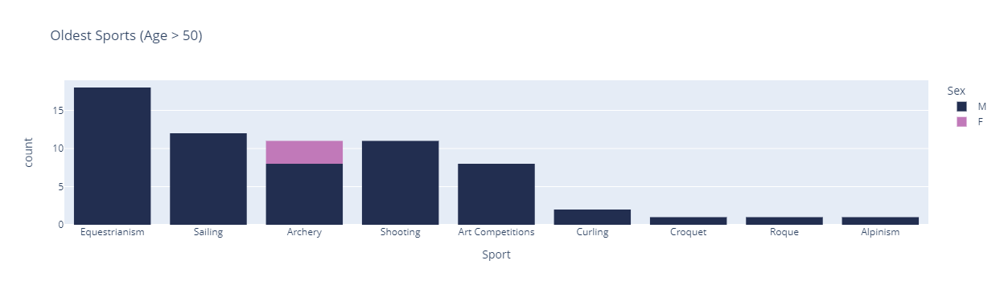

In [7]:
agedMedals = goldMedals[goldMedals['Age'] > 50]


fig = px.histogram(data_frame = agedMedals,title="Oldest Sports (Age > 50)", x ="Sport", color="Sex", color_discrete_map={
                                                        "M":"#222E50", 
                                                        "F":"#C179B9"}).update_xaxes(categoryorder='total descending')

fig.show()

### Sports that gold medalists under 14 years old play:

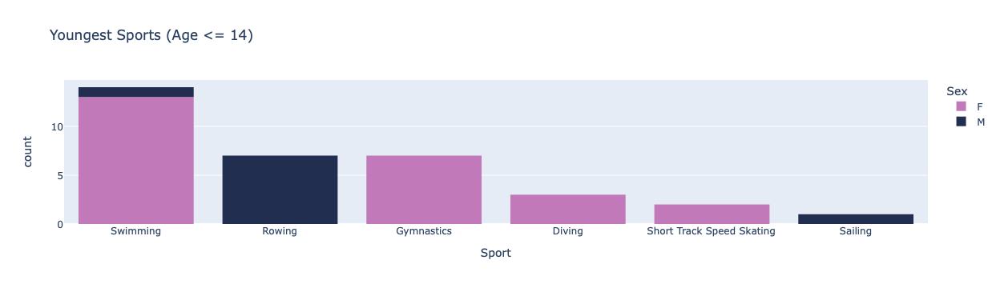

In [8]:
agedMedals = goldMedals[goldMedals['Age'] <= 14]


fig = px.histogram(data_frame = agedMedals,title="Youngest Sports (Age <= 14)", x ="Sport", color="Sex", color_discrete_map={
                                                        "M":"#222E50", 
                                                        "F":"#C179B9"}).update_xaxes(categoryorder='total descending')

fig.show()

### Variation of age over time

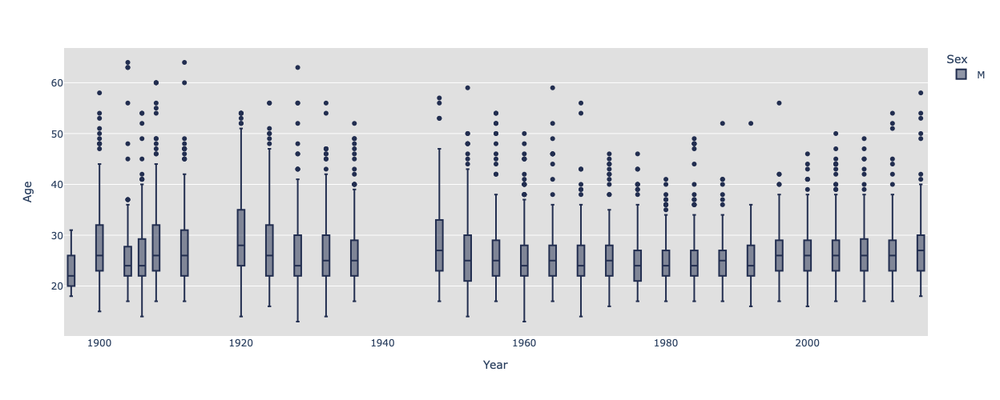

In [9]:
menOnly = goldMedals[goldMedals['Sex'] == "M" ]
menOnly = menOnly[(menOnly['Season'] == 'Summer')]

fig = px.box(data_frame = menOnly, y="Age", x="Year", height= 500,color="Sex", color_discrete_map={
                                                        "M":"#222E50", 
                                                        "F":"#C179B9"})
fig.update_layout({
'plot_bgcolor': '#E0E0E0',
'paper_bgcolor': 'rgba(0, 0, 0, 0)',
})

fig.show()


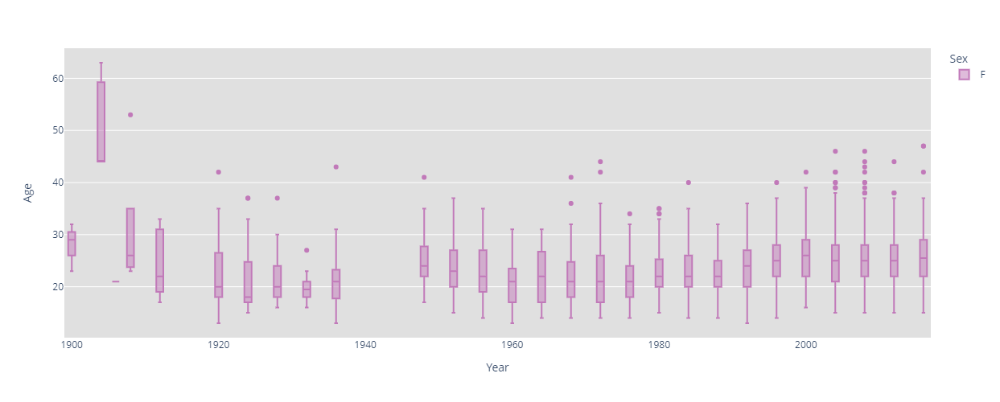

In [10]:
womenOnly = goldMedals[goldMedals['Sex'] == "F" ]
womenOnly = womenOnly[(womenOnly['Season'] == 'Summer')]

fig = px.box(data_frame = womenOnly, y="Age", x="Year", height= 500,color="Sex", color_discrete_map={
                                                        "M":"#222E50", 
                                                        "F":"#C179B9"})
fig.update_layout({
'plot_bgcolor': '#E0E0E0',
'paper_bgcolor': 'rgba(0, 0, 0, 0)',
})

fig.show()


# 2. Height vs Weight of gold medals

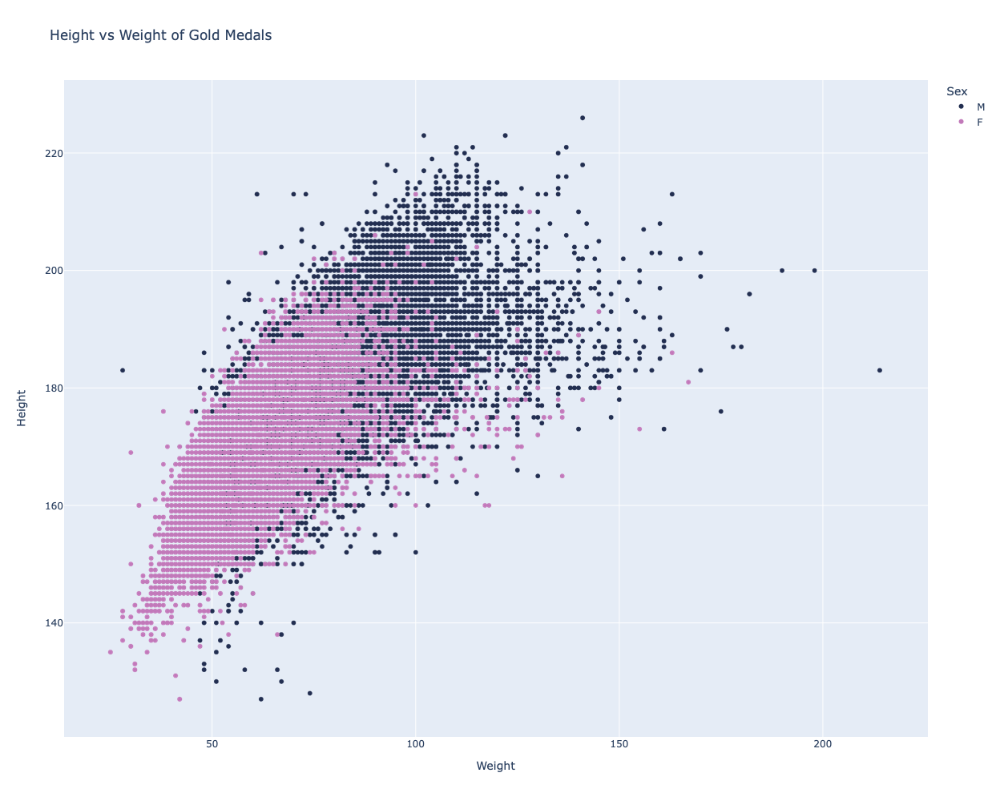

In [11]:
fig = px.scatter(data, x = "Weight", title="Height vs Weight of Gold Medals" , y = "Height", height = 1000, width= 800, color="Sex", color_discrete_map={
                                                        "M":"#222E50", 
                                                        "F":"#C179B9"})
fig.show()

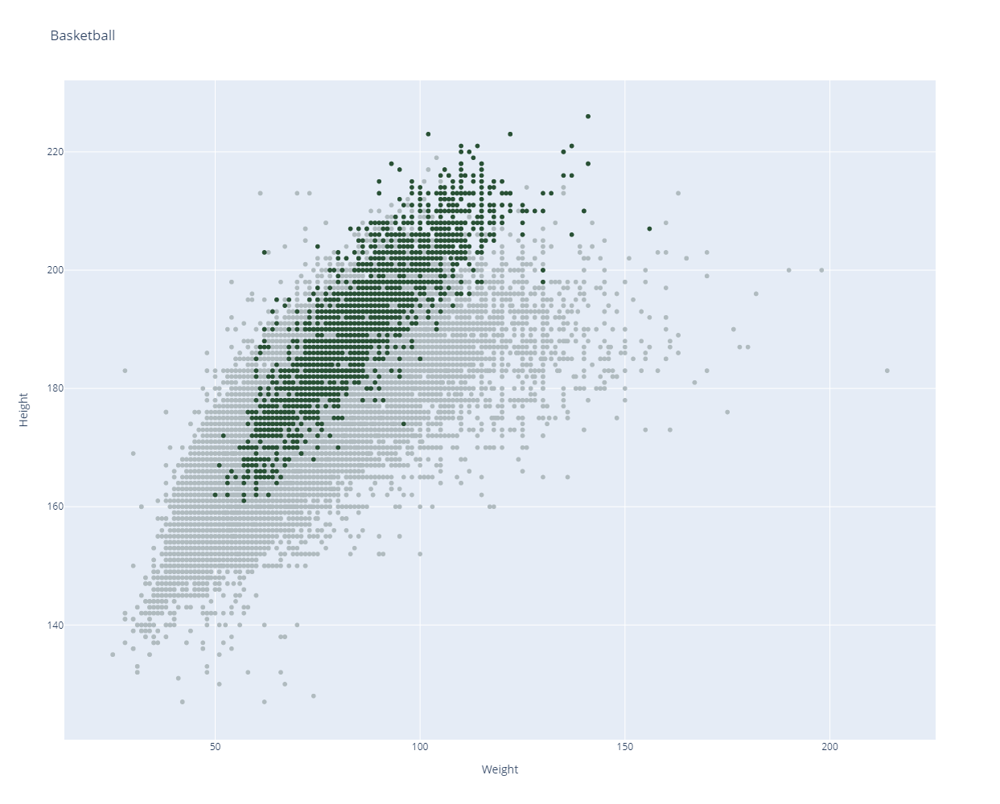

Aeronautics
Alpine Skiing
Alpinism
Archery
Art Competitions
Athletics
Badminton
Baseball
Basketball
Basque Pelota
Beach Volleyball
Biathlon
Bobsleigh
Boxing
Canoeing
Cricket
Croquet
Cross Country Skiing
Curling
Cycling
Diving
Equestrianism
Fencing
Figure Skating
Football
Freestyle Skiing
Golf
Gymnastics
Handball
Hockey
Ice Hockey
Jeu De Paume
Judo
Lacrosse
Luge
Military Ski Patrol
Modern Pentathlon
Motorboating
Nordic Combined
Polo
Racquets
Rhythmic Gymnastics
Roque
Rowing
Rugby
Rugby Sevens
Sailing
Shooting
Short Track Speed Skating
Skeleton
Ski Jumping
Snowboarding
Softball
Speed Skating
Swimming
Synchronized Swimming
Table Tennis
Taekwondo
Tennis
Trampolining
Triathlon
Tug-Of-War
Volleyball
Water Polo
Weightlifting
Wrestling


In [28]:
maleAthletes = data[data["Sex"] == "M"]
    
def scatterPlotOfSport(sport):
    athletesNotOfSport=data[(data['Sport'] != sport)]
    
    for althetes in athletesNotOfSport:
        athletesNotOfSport['Sport'] = 'Other'
    
    athletesOfSport=data[(data['Sport'] == sport)]
    
    bigdata = athletesNotOfSport.append(athletesOfSport, ignore_index=True)
    
    fig = px.scatter(bigdata, x = "Weight", y = "Height", title=sport, height = 1000, width= 800, color="Sport", color_discrete_map={ 
                                                        "Other":"#B0BBBF",
                                                        sport:"#295135"},
                                                        opacity = 1)
    fig.update_layout(showlegend=False)
    fig.show()
    
Sports = goldMedals["Sport"].sort_values().unique().tolist()


scatterPlotOfSport('Basketball')
#scatterPlotOfSport('Figure Skating')
#scatterPlotOfSport('Beach Volleyball')


for sport in Sports:
    print(sport)
    #scatterPlotOfSport(sport)

### Height vs Weight of a specific sport:

In [13]:
def medalled_athletes_scatter(sport):
    """
    takes a medal type and sport type, 
    gives a scatter plot for weight-height relation
    """
    athletes=goldMedals[(goldMedals['Sport']==sport)]
    fig = px.scatter(athletes, x = "Weight", y = "Height", height = 1000, width= 800, color="Sex", color_discrete_map={
                                                        "M":"#222E50", 
                                                        "F":"#C179B9"})
    fig.update_layout({
    'plot_bgcolor': '#E0E0E0',
    'paper_bgcolor': 'rgba(0, 0, 0, 0)',
    })

    fig.show()
    
#medalled_athletes_scatter('Gymnastics')


### Figure Skating:

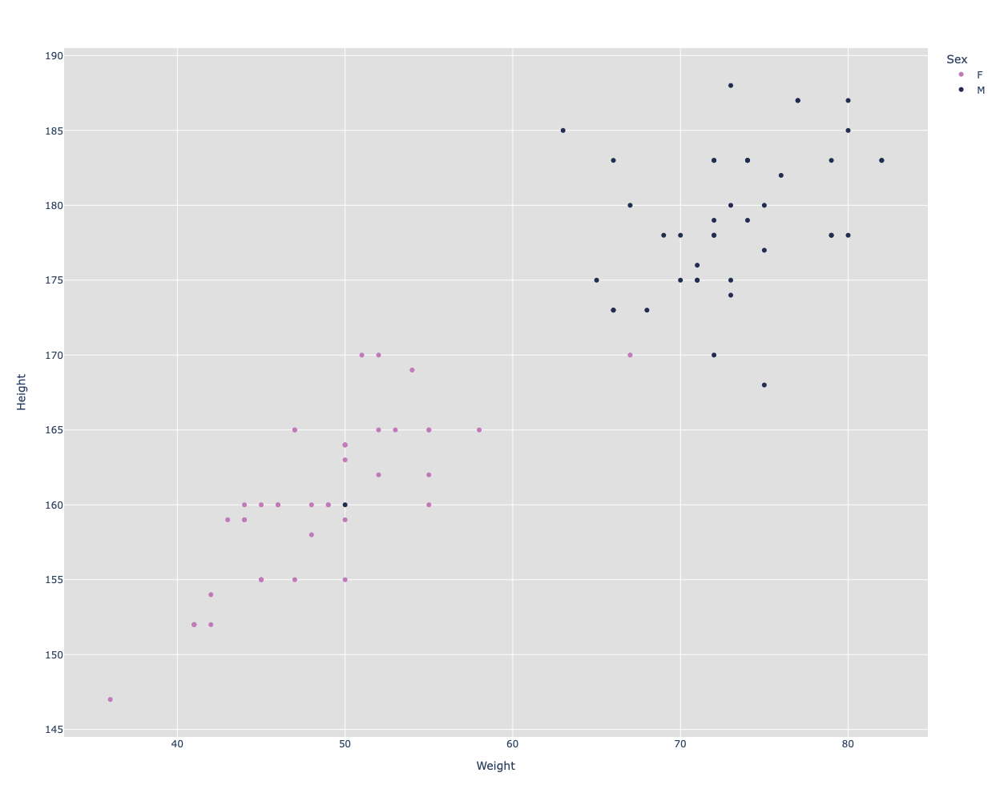

In [14]:
medalled_athletes_scatter('Figure Skating')

### Football

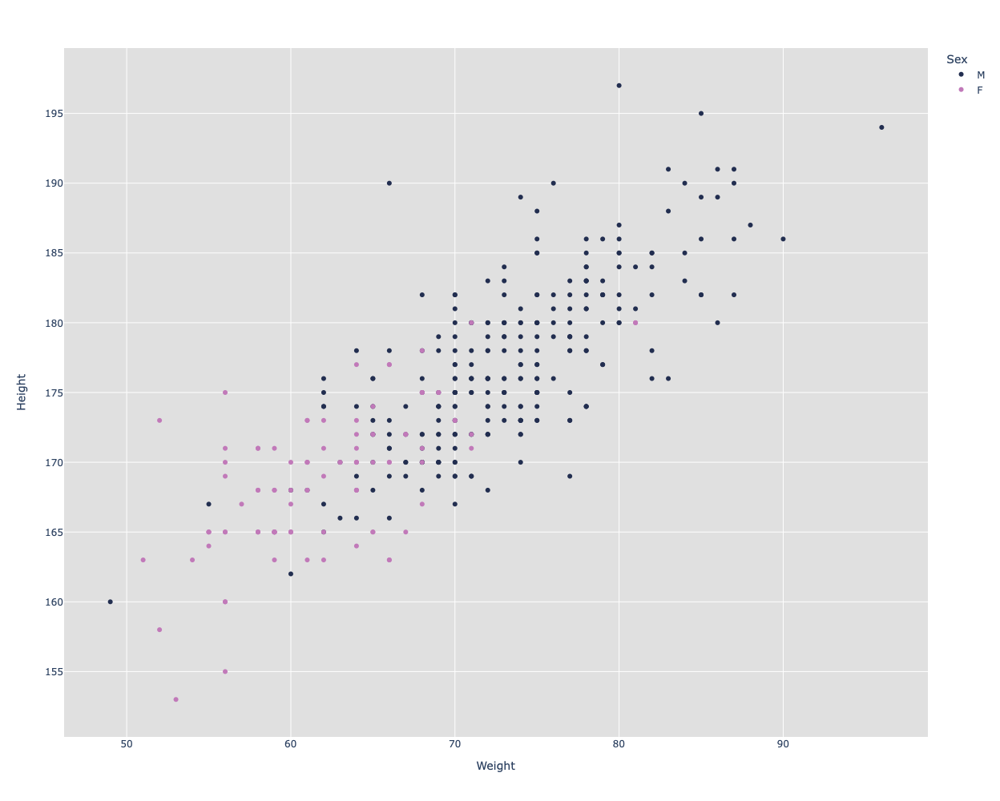

In [15]:
medalled_athletes_scatter('Football')

### Sports that heaviest gold medalists play:

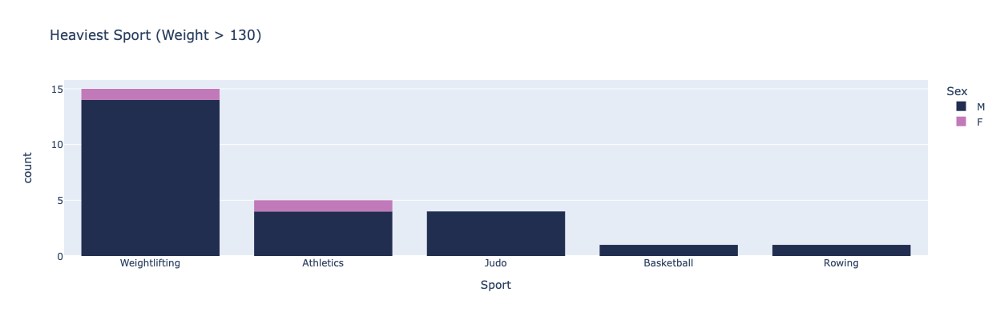

In [34]:
fig = weightMedals = goldMedals[goldMedals['Weight'] > 130]


fig = px.histogram(data_frame = weightMedals, height = 400, title="Heaviest Sport (Weight > 130)", x ="Sport",color="Sex", color_discrete_map={
                                                        "M":"#222E50", 
                                                        "F":"#C179B9"}).update_xaxes(categoryorder='total descending')
fig.show()


### Sports that lightest gold medalists play:

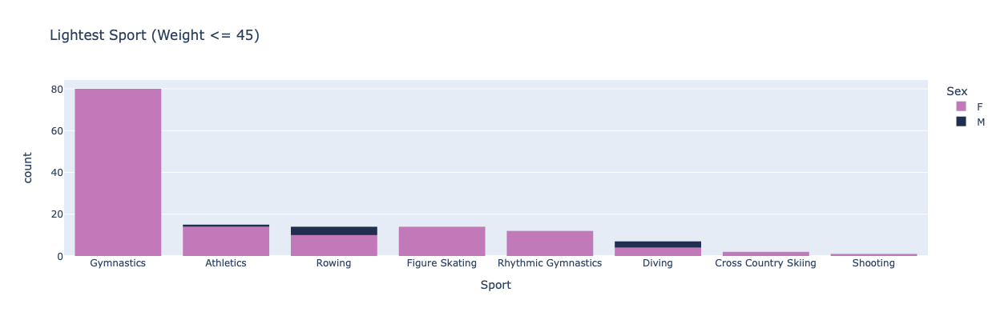

In [36]:
fig = weightMedals = goldMedals[goldMedals['Weight'] <= 45]


fig = px.histogram(data_frame = weightMedals, height = 400,title="Lightest Sport (Weight <= 45)", x ="Sport",color="Sex", color_discrete_map={
                                                        "M":"#222E50", 
                                                        "F":"#C179B9"}).update_xaxes(categoryorder='total descending')
fig.show()


### Sports that the tallest gold medalists play:

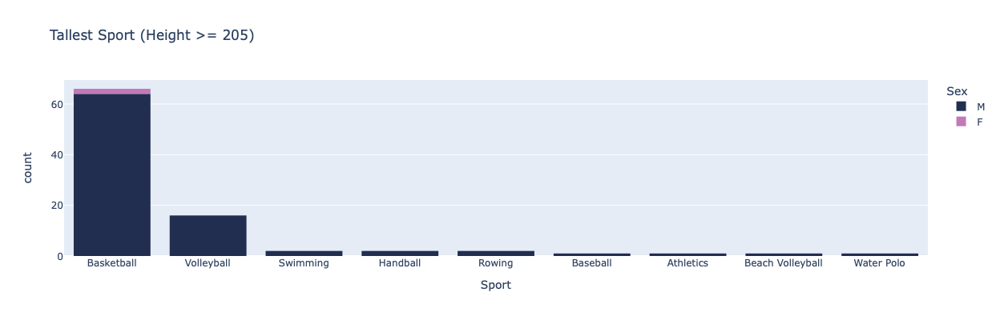

In [37]:
fig = weightMedals = goldMedals[goldMedals['Height'] >= 205]


fig = px.histogram(data_frame = weightMedals, height = 400,title="Tallest Sport (Height >= 205)", x ="Sport",color="Sex", color_discrete_map={
                                                        "M":"#222E50", 
                                                        "F":"#C179B9"}).update_xaxes(categoryorder='total descending')
fig.show()


### Sports that the shortest gold medalists play:


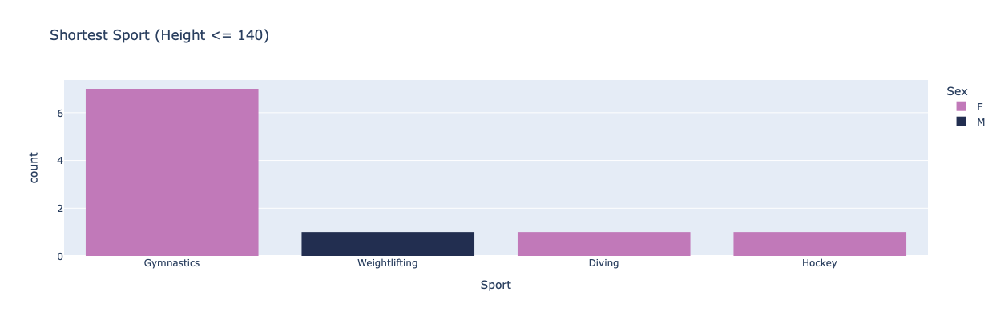

In [38]:
fig = weightMedals = goldMedals[goldMedals['Height'] <= 140]


fig = px.histogram(data_frame = weightMedals,height = 400,title="Shortest Sport (Height <= 140)", x ="Sport",color="Sex", color_discrete_map={
                                                        "M":"#222E50", 
                                                        "F":"#C179B9"}).update_xaxes(categoryorder='total descending')
fig.show()


# Female vs male Percentage of gold medals over time

In [1]:
OL = data.loc[:,["Year", "ID", "Sex"]].drop_duplicates().groupby(["Year", "Sex"]).size().reset_index()
OL.columns = ["Year","Sex","Count"]

Years = data["Year"].sort_values().unique().tolist()

Female = []
Male = []

for year in Years:
    Female.append(
        OL[(OL["Year"] == year) & (OL["Sex"] == 'F')]["Count"].sum()/
        OL[(OL["Year"] == year)]["Count"].sum()*100
    )
    
    Male.append(
        OL[(OL["Year"] == year) & (OL["Sex"] == 'M')]["Count"].sum()/
        OL[(OL["Year"] == year)]["Count"].sum()*100
    )

fig2 = go.Figure(data=[
        go.Bar(name='M', x=Years, y=Male, marker_color='#222E50'),
        go.Bar(name='F', x=Years, y=Female, marker_color='#C179B9')])
fig2.update_layout(barmode='stack')
fig2.update_layout(title='Male vs Female Athletes Percentage over Time')
fig2.update_xaxes(type='category')


fig2.show()

NameError: name 'data' is not defined